In [ ]:
# Fix for Python 3.12 compatibility
import os
os.environ['STARDIST_USE_GPUTOOLS'] = 'false'

# Monkey-patch configparser for gputools compatibility
import configparser
if not hasattr(configparser, 'SafeConfigParser'):
    configparser.SafeConfigParser = configparser.ConfigParser

In [199]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import os

from skimage.color import label2rgb
from skimage.measure import label
from sklearn.model_selection import train_test_split

from stardist.models import StarDist2D, Config2D
from stardist.matching import matching
from csbdeep.utils import normalize

In [241]:
training_data = [
    {
        'image': 'star/images/cropped_img1.png',  
        'mask': 'star/images/cropped_mask1.png', 
    },
    {
        'image': 'star/images/cropped_img2.png',
        'mask': 'star/images/cropped_mask2.png',
    }
]

In [173]:
testing_data = [
    'star/images/cropped_img1.png',  
    'star/images/cropped_img2.png',  
    'star/images/cropped_unseen1.png',  
    'star/images/rocks4.jpg',  
    'star/images/unseen_img2.png'
]

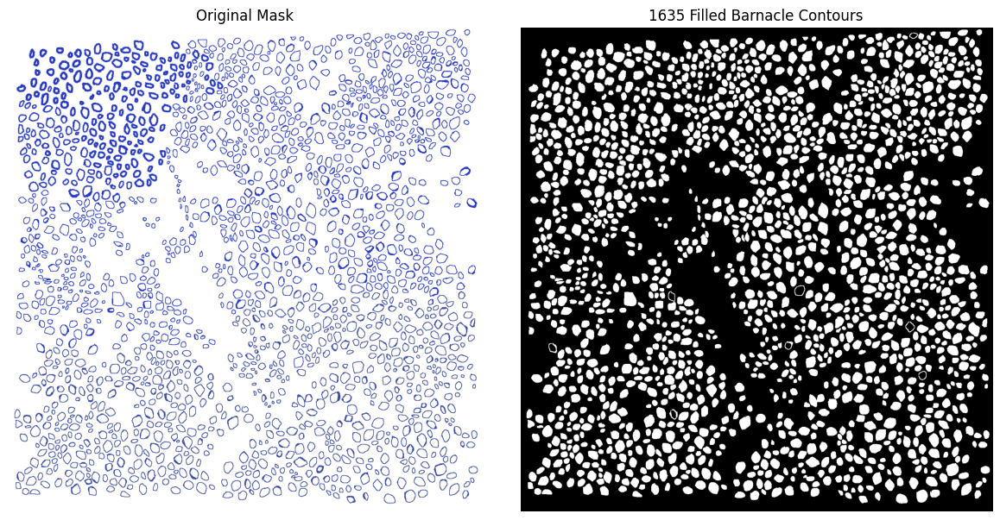

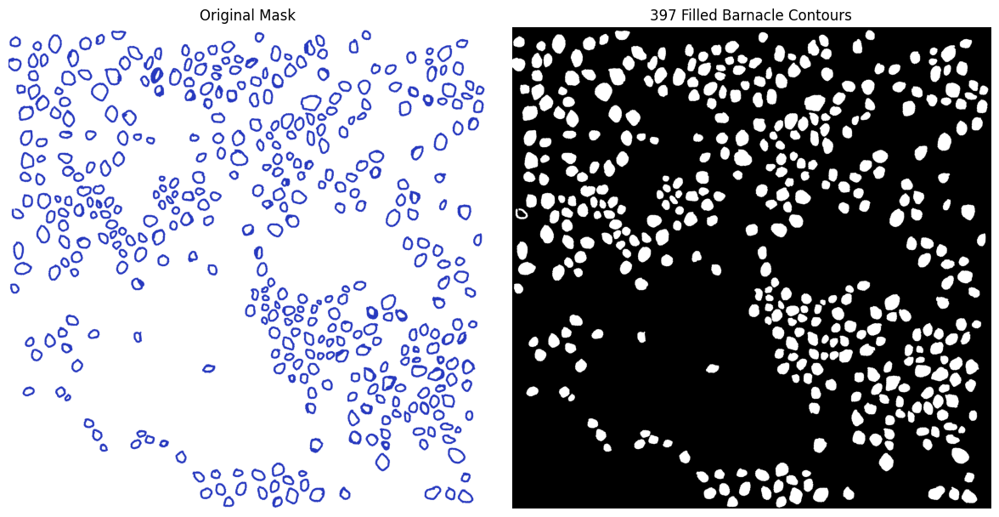

In [200]:
images = []
labels = [] 

for d in training_data: 
    img = cv.imread(d['image'], cv.IMREAD_GRAYSCALE)
    mask = cv.imread(d['mask'], cv.IMREAD_COLOR)
    gray = cv.cvtColor(mask, cv.COLOR_BGR2GRAY)
    _, thresh = cv.threshold(gray, 240, 255, cv.THRESH_BINARY_INV)
    contours, _ = cv.findContours(thresh, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)

    valid_contours = []
    for cnt in contours:
        area = cv.contourArea(cnt)
        if 100 < area < 5000:
            valid_contours.append(cnt)

    filled = np.zeros(gray.shape, dtype=np.uint8)
    cv.drawContours(filled, valid_contours, -1, 255, -1)


    base, ext = os.path.splitext(d['mask'])
    out_path = f"{base}_filled{ext}"
    cv.imwrite(out_path, filled)


    barnacles = []
    for contour in valid_contours:
        area = cv.contourArea(contour)
        
        individual_mask = np.zeros(gray.shape, dtype=np.uint8)
        cv.drawContours(individual_mask, [contour], -1, 255, -1)

        M = cv.moments(contour)
        if M['m00'] > 0:
            cx = int(M['m10'] / M['m00'])
            cy = int(M['m01'] / M['m00'])

            barnacles.append({
                'centroid': (cx, cy),
                'mask': individual_mask,
                'area': area,
                'contour': contour
            })
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    axes[0].imshow(cv.cvtColor(mask, cv.COLOR_BGR2RGB))
    axes[0].set_title("Original Mask")
    axes[0].axis("off")

    axes[1].imshow(filled, cmap="gray")
    axes[1].set_title(f"{(len(barnacles))} Filled Barnacle Contours")
    axes[1].axis("off")
    
    plt.tight_layout()
    plt.show()

    #relabelling bc stardist wants sequential labels 
    label_img = np.zeros(img.shape, dtype=np.uint16)
    
    for idx, barnacle in enumerate(barnacles, start=1):
        contour = barnacle['contour']
        cv.drawContours(label_img, [contour], -1, idx, -1)
    
    images.append(img)
    labels.append(label_img)

In [242]:
training_data = [
    {
        'image': 'star/images/cropped_img1.png',  
        'mask': 'star/images/cropped_mask1.png', 
        'filled': 'star/images/cropped_mask1_filled.png'
    },
    {
        'image': 'star/images/cropped_img2.png',
        'mask': 'star/images/cropped_mask2.png',
        'filled': 'star/images/cropped_mask2_filled.png'
    }
]

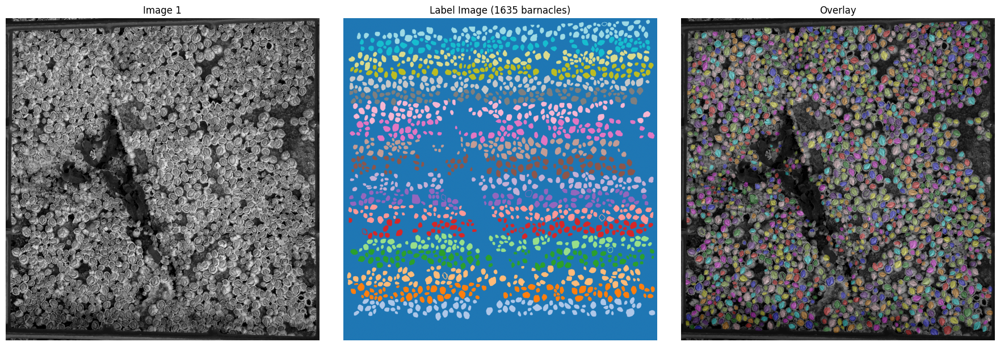

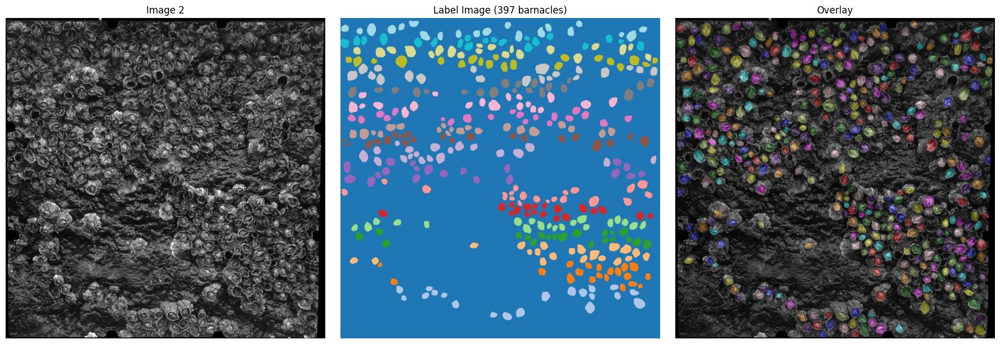

In [201]:
for i in range (len(images)): 
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    
    axes[0].imshow(images[i], cmap='gray')
    axes[0].set_title(f'Image {i+1}')
    axes[0].axis('off')
    
    axes[1].imshow(labels[i], cmap='tab20')
    axes[1].set_title(f'Label Image ({labels[i].max()} barnacles)')
    axes[1].axis('off')
    
    overlay = label2rgb(labels[i], images[i], bg_label=0, alpha=0.3)
    axes[2].imshow(overlay)
    axes[2].set_title('Overlay')
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()

In [234]:
# used claude to come up w eval metrics
def plot_training_history(history, title='Training History'):
    fig, axes = plt.subplots(1, 3, figsize=(15, 4))
    
    metrics = [
        ('loss', 'val_loss', 'Total Loss'),
        ('dist_loss', 'val_dist_loss', 'Distance Loss'),
        ('prob_loss', 'val_prob_loss', 'Probability Loss'),
    ]
    
    for ax, (train_key, val_key, ylabel) in zip(axes, metrics):
        ax.plot(history.history[train_key], label='train')
        ax.plot(history.history[val_key], label='val')
        ax.set_xlabel('Epoch')
        ax.set_ylabel(ylabel)
        ax.legend()
        ax.set_title(ylabel)
        ax.grid(alpha=0.3)
    
    plt.suptitle(title, fontsize=14)
    plt.tight_layout()
    plt.show()

def evaluate_model(model, image, ground_truth, prob_thresh=0.6, iou_thresh=0.6):
    img_norm = normalize(image, 1, 99.8)
    pred, _ = model.predict_instances(img_norm, prob_thresh=prob_thresh)
    matches = matching(ground_truth, pred, thresh=iou_thresh)
    
    return {
        'prediction': pred,
        'gt_count': ground_truth.max(),
        'pred_count': pred.max(),
        'precision': matches.precision,
        'recall': matches.recall,
        'f1': matches.f1,
    }


def visualize_prediction(image, prediction, title='Prediction', ground_truth=None):
    n_cols = 3 if ground_truth is not None else 2
    fig, axes = plt.subplots(1, n_cols, figsize=(6 * n_cols, 6))
    
    axes[0].imshow(image, cmap='gray')
    axes[0].set_title('Original')
    axes[0].axis('off')
    
    overlay = label2rgb(prediction, image, bg_label=0, alpha=0.3)
    axes[1].imshow(overlay)
    axes[1].set_title(f'{title} ({prediction.max()} detected)')
    axes[1].axis('off')
    
    if ground_truth is not None:
        gt_overlay = label2rgb(ground_truth, image, bg_label=0, alpha=0.3)
        axes[2].imshow(gt_overlay)
        axes[2].set_title(f'Ground Truth ({ground_truth.max()} barnacles)')
        axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()

In [202]:
#creating patches for artifically augmenting data 
image_patches = []
label_patches = []
patch_size = 512

for i, l in zip(images, labels):
    h, w = i.shape
    
    extracted = 0
    attempts = 0

    while extracted < 15 and attempts < 75:
        attempts += 1
        
        y = np.random.randint(0, h - patch_size)
        x = np.random.randint(0, w - patch_size)
        
        img_patch = i[y:y+patch_size, x:x+patch_size]
        lbl_patch = l[y:y+patch_size, x:x+patch_size]
        
        #min barnacles = 3
        if lbl_patch.max() >= 3:

            unique_labels = np.unique(lbl_patch)
            unique_labels = unique_labels[unique_labels > 0]  
            
            relabeled = np.zeros_like(lbl_patch)
            for new_id, old_id in enumerate(unique_labels, start=1):
                relabeled[lbl_patch == old_id] = new_id
            
            image_patches.append(img_patch)
            label_patches.append(relabeled)
            extracted += 1


print(f"{len(image_patches)}  patches")
print(f"shape: {image_patches[0].shape}")

30  patches
shape: (512, 512)


Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.
Ground truth: 1635 barnacles
Detected: 1634 barnacles
Precision: 0.182
Recall: 0.182
F1 Score: 0.182


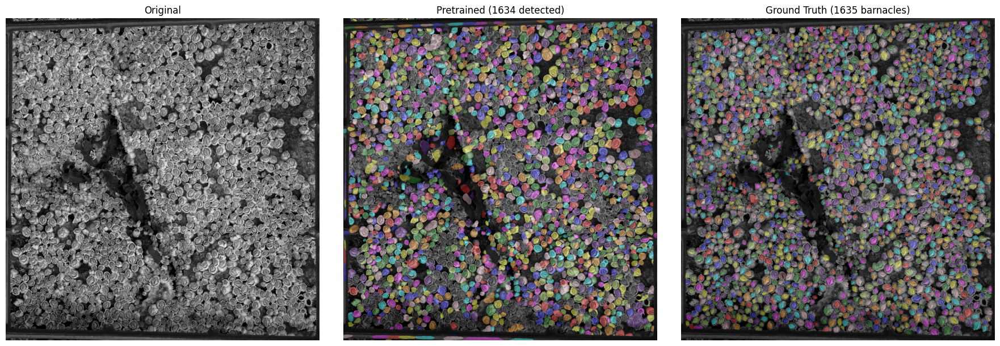

Ground truth: 397 barnacles
Detected: 452 barnacles
Precision: 0.135
Recall: 0.154
F1 Score: 0.144


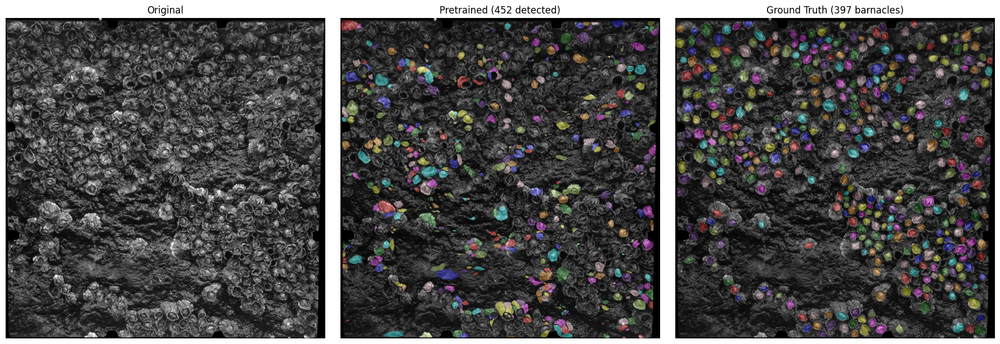

In [209]:
model = StarDist2D.from_pretrained('2D_versatile_fluo')


for d in training_data: 
    img = cv.imread(d["image"], cv.IMREAD_GRAYSCALE)
    l = label(cv.imread(d["filled"], cv.IMREAD_GRAYSCALE))
    results = evaluate_model(model, img, l)

    print(f"Ground truth: {results['gt_count']} barnacles")
    print(f"Detected: {results['pred_count']} barnacles")
    print(f"Precision: {results['precision']:.3f}")
    print(f"Recall: {results['recall']:.3f}")
    print(f"F1 Score: {results['f1']:.3f}")
    
    visualize_prediction(img, results['prediction'], 'Pretrained', l)


In [161]:
# normalizing images for training
img_norm = np.array([normalize(x, 1, 99.8) for x in image_patches])

print(f"Normalized training data shape: {img_norm.shape}")

# stardist config
n_rays = 32  

conf = Config2D(
    n_rays=n_rays,
    grid=(2, 2), 
    use_gpu=True,
    n_channel_in=1,  
    train_epochs=50,
    train_steps_per_epoch=100,
    train_batch_size=2,
    train_learning_rate=0.0001, # small learning rate for ft 
    train_patch_size=(256, 256),  #more aug
)

print("Model Configuration:")
print(conf)

Normalized training data shape: (30, 512, 512)
Model Configuration:
Config2D(n_dim=2, axes='YXC', n_channel_in=1, n_channel_out=33, train_checkpoint='weights_best.h5', train_checkpoint_last='weights_last.h5', train_checkpoint_epoch='weights_now.h5', n_rays=32, grid=(2, 2), backbone='unet', n_classes=None, unet_n_depth=3, unet_kernel_size=(3, 3), unet_n_filter_base=32, unet_n_conv_per_depth=2, unet_pool=(2, 2), unet_activation='relu', unet_last_activation='relu', unet_batch_norm=False, unet_dropout=0.0, unet_expansion=2, unet_prefix='', net_conv_after_unet=128, net_input_shape=(None, None, 1), net_mask_shape=(None, None, 1), train_shape_completion=False, train_completion_crop=32, train_patch_size=(256, 256), train_background_reg=0.0001, train_foreground_only=0.9, train_sample_cache=True, train_dist_loss='mae', train_loss_weights=(1, 0.2), train_class_weights=(1, 1), train_epochs=50, train_steps_per_epoch=100, train_learning_rate=0.0001, train_batch_size=2, train_n_val_patches=None, trai

In [162]:
def augment(x, y):
    if np.random.rand() > 0.5:
        x = np.fliplr(x)
        y = np.fliplr(y)
    if np.random.rand() > 0.5:
        x = np.flipud(x)
        y = np.flipud(y)
    if np.random.rand() > 0.5:
        k = np.random.randint(1, 4)
        x = np.rot90(x, k)
        y = np.rot90(y, k)
    return x, y

In [163]:
model_finetuned = StarDist2D(conf, name='barnacle_finetuned', basedir='star/models')
model_finetuned.keras_model.set_weights(model.keras_model.get_weights())
print("starting fine-tuning")

history = model_finetuned.train(
    img_norm, label_patches,
    validation_data=(img_norm, label_patches), #tried with val and train being the same and it worked p good, so i leave it be
    augmenter=augment,
    epochs=50
)

Using default values: prob_thresh=0.5, nms_thresh=0.4.
starting fine-tuning
Epoch 1/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 17s 146ms/step - dist_dist_iou_metric: 0.5359 - dist_loss: 4.7016 - dist_relevant_mae: 4.7006 - dist_relevant_mse: 45.8046 - loss: 1.2447 - prob_kld: 0.1610 - prob_loss: 0.3044 - val_dist_dist_iou_metric: 0.5769 - val_dist_loss: 4.0691 - val_dist_relevant_mae: 4.0681 - val_dist_relevant_mse: 33.8721 - val_loss: 1.1058 - val_prob_kld: 0.1468 - val_prob_loss: 0.2920 - learning_rate: 1.0000e-04
Epoch 2/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 14s 143ms/step - dist_dist_iou_metric: 0.6047 - dist_loss: 3.7473 - dist_relevant_mae: 3.7463 - dist_relevant_mse: 28.9146 - loss: 1.0306 - prob_kld: 0.1365 - prob_loss: 0.2812 - val_dist_dist_iou_metric: 0.6318 - val_dist_loss: 3.5167 - val_dist_relevant_mae: 3.5157 - val_dist_relevant_mse: 26.4846 - val_loss: 0.9742 - val_prob_kld: 0.1257 - val_prob_loss: 0.2709 - learning_rate: 1.0000e-04
Epoch 3/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 14s 143ms/step

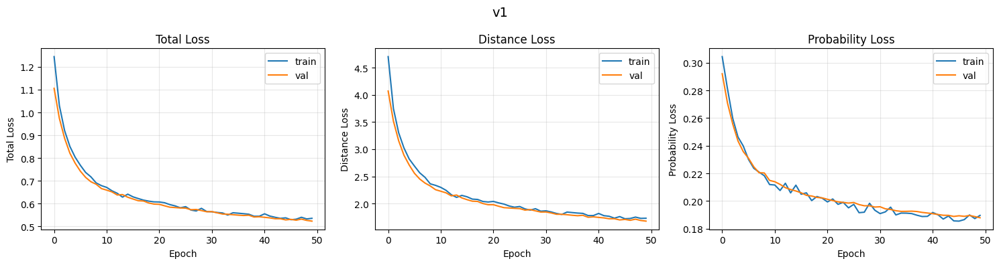

In [221]:
plot_training_history(history, 'v1')

In [229]:
thresh = model_finetuned.optimize_thresholds(img_val_norm, label_val)
prob_thresh =  thresh['prob']
print(prob_thresh)

NMS threshold = 0.5:  75%|███████▌  | 15/20 [00:06<00:02,  2.22it/s, 0.737 -> 0.710]


Using optimized values: prob_thresh=0.734414, nms_thresh=0.3.
Saving to 'thresholds.json'.
0.7344135642051697


Ground truth: 1635 barnacles
Detected: 1501 barnacles
Precision: 0.932
Recall: 0.856
F1 Score: 0.892


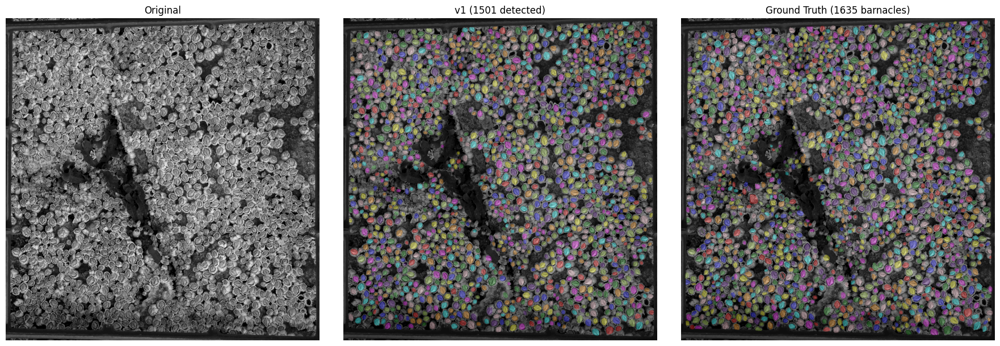

Ground truth: 397 barnacles
Detected: 335 barnacles
Precision: 0.964
Recall: 0.814
F1 Score: 0.883


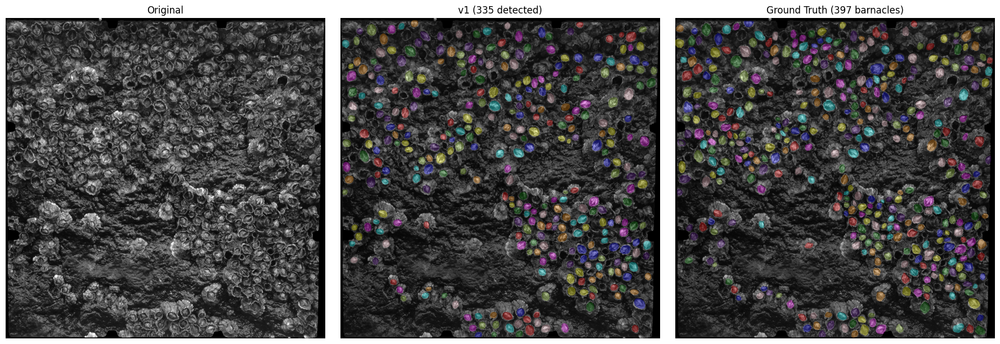

In [230]:
for d in training_data: 
    img = cv.imread(d["image"], cv.IMREAD_GRAYSCALE)
    l = label(cv.imread(d["filled"], cv.IMREAD_GRAYSCALE))
    results = evaluate_model(model_finetuned, img, l, prob_thresh)

    print(f"Ground truth: {results['gt_count']} barnacles")
    print(f"Detected: {results['pred_count']} barnacles")
    print(f"Precision: {results['precision']:.3f}")
    print(f"Recall: {results['recall']:.3f}")
    print(f"F1 Score: {results['f1']:.3f}")
    
    visualize_prediction(img, results['prediction'], 'v1', l)


In [165]:
negative_images = [
    'star/negs/rocks1.jpg',     
    'star/negs/coins2.jpg',     
    'star/negs/coins3.jpg',         
]

In [166]:
image_patches_negative = []
label_patches_negative = []

for neg_path in negative_images:
    img = cv.imread(neg_path, cv.IMREAD_GRAYSCALE)
    
    h, w = img.shape
    print(h, w)
    for _ in range(2):
        if h < patch_size or w < patch_size:
            img_patch = cv.resize(img, (patch_size, patch_size))
        else:
            y = np.random.randint(0, h - patch_size)
            x = np.random.randint(0, w - patch_size)
            img_patch = img[y:y+patch_size, x:x+patch_size]

        lbl_patch = np.zeros((patch_size, patch_size), dtype=np.uint16)
        
        image_patches_negative.append(img_patch)
        label_patches_negative.append(lbl_patch)

print(f"Negative patches (no barnacles): {len(image_patches_negative)}")

408 612
1200 900
607 910
Negative patches (no barnacles): 6


In [167]:
all_image_patches = image_patches + image_patches_negative
all_label_patches = label_patches + label_patches_negative

print(len(all_image_patches))

all_Images = np.array(all_image_patches)
all_labels = np.array(all_label_patches)

img_train, img_val, label_train, label_val = train_test_split(
    all_Images, all_labels, 
    test_size=0.2,      
    random_state=42,    
    shuffle=True        
)

print(len(img_train), len(img_val))

img_train_norm = np.array([normalize(x, 1, 99.8) for x in img_train])
img_val_norm = np.array([normalize(x, 1, 99.8) for x in img_val])

36
28 8


In [168]:
conf_v2 = Config2D(
    n_rays=32,
    grid=(2, 2),
    use_gpu=True,
    n_channel_in=1,
    train_epochs=50,           
    train_steps_per_epoch=100,
    train_batch_size=2,        
    train_learning_rate=0.0001,
    train_patch_size=(256, 256),
)

model_v2 = StarDist2D(conf_v2, name='barnacle_v2_with_negatives', basedir='star/models')
model_v2.keras_model.set_weights(model.keras_model.get_weights())  


history_v2 = model_v2.train(
    img_train_norm, label_train,
    validation_data=(img_val_norm, label_val), 
    augmenter=augment,
    epochs=50
)

Using default values: prob_thresh=0.5, nms_thresh=0.4.
Epoch 1/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 26s 226ms/step - dist_dist_iou_metric: 0.5300 - dist_loss: 4.6330 - dist_relevant_mae: 4.6318 - dist_relevant_mse: 44.6283 - loss: 1.2038 - prob_kld: 0.1528 - prob_loss: 0.2772 - val_dist_dist_iou_metric: 0.4283 - val_dist_loss: 3.2989 - val_dist_relevant_mae: 3.2977 - val_dist_relevant_mse: 28.3904 - val_loss: 0.9063 - val_prob_kld: 0.1465 - val_prob_loss: 0.2465 - learning_rate: 1.0000e-04
Epoch 2/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 216ms/step - dist_dist_iou_metric: 0.5887 - dist_loss: 3.7648 - dist_relevant_mae: 3.7636 - dist_relevant_mse: 30.0125 - loss: 1.0085 - prob_kld: 0.1307 - prob_loss: 0.2555 - val_dist_dist_iou_metric: 0.4605 - val_dist_loss: 3.0298 - val_dist_relevant_mae: 3.0286 - val_dist_relevant_mse: 25.3657 - val_loss: 0.8358 - val_prob_kld: 0.1298 - val_prob_loss: 0.2298 - learning_rate: 1.0000e-04
Epoch 3/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 217ms/step - dist_dist_iou_metr

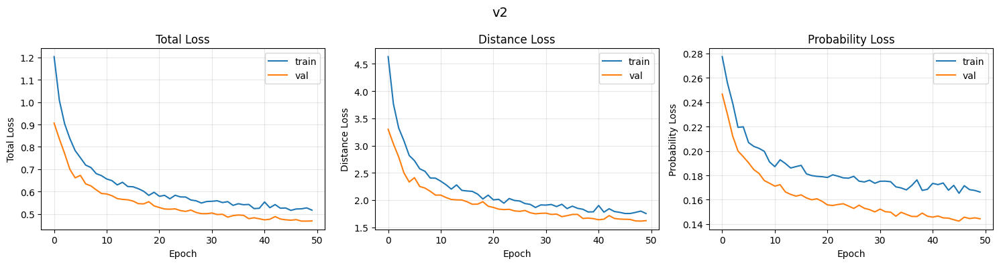

In [222]:
plot_training_history(history_v2, 'v2')

In [228]:
thresh2 = model_v2.optimize_thresholds(img_val_norm, label_val)
prob_thresh2 =  thresh2['prob']
print(prob_thresh2)

NMS threshold = 0.5:  75%|███████▌  | 15/20 [00:06<00:02,  2.38it/s, 0.652 -> 0.718]


Using optimized values: prob_thresh=0.64968, nms_thresh=0.3.
Saving to 'thresholds.json'.
0.6496800184249878


Ground truth: 1635 barnacles
Detected: 1517 barnacles
Precision: 0.922
Recall: 0.855
F1 Score: 0.887


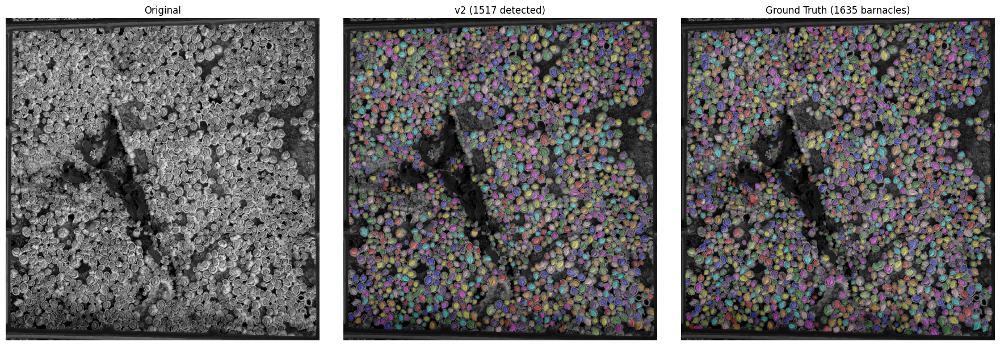

Ground truth: 397 barnacles
Detected: 338 barnacles
Precision: 0.956
Recall: 0.814
F1 Score: 0.879


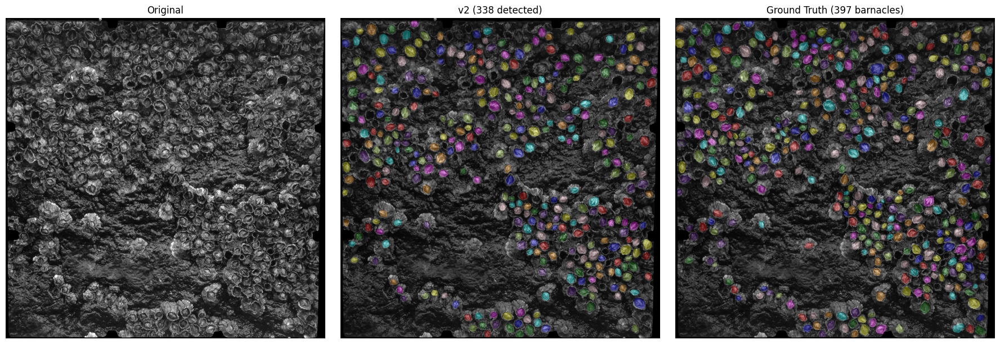

In [231]:
for d in training_data: 
    img = cv.imread(d["image"], cv.IMREAD_GRAYSCALE)
    l = label(cv.imread(d["filled"], cv.IMREAD_GRAYSCALE))
    results = evaluate_model(model_v2, img, l, prob_thresh2)

    print(f"Ground truth: {results['gt_count']} barnacles")
    print(f"Detected: {results['pred_count']} barnacles")
    print(f"Precision: {results['precision']:.3f}")
    print(f"Recall: {results['recall']:.3f}")
    print(f"F1 Score: {results['f1']:.3f}")
    
    visualize_prediction(img, results['prediction'], 'v2', l)



star/negs/rocks1.jpg:
  v1 (no negatives): detected 13 'barnacles' (false positives)
  v2 (with negatives): detected 18 'barnacles' (false positives)


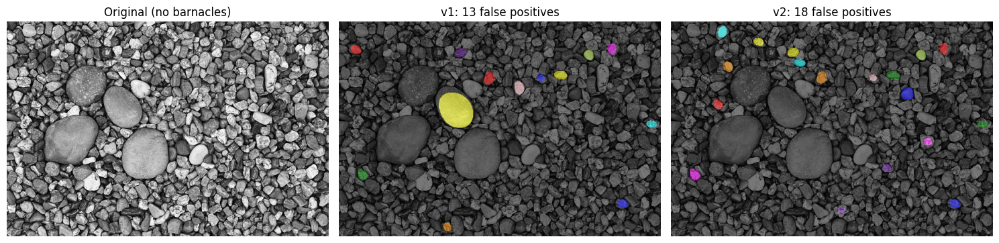


star/negs/coins2.jpg:
  v1 (no negatives): detected 17 'barnacles' (false positives)
  v2 (with negatives): detected 2 'barnacles' (false positives)


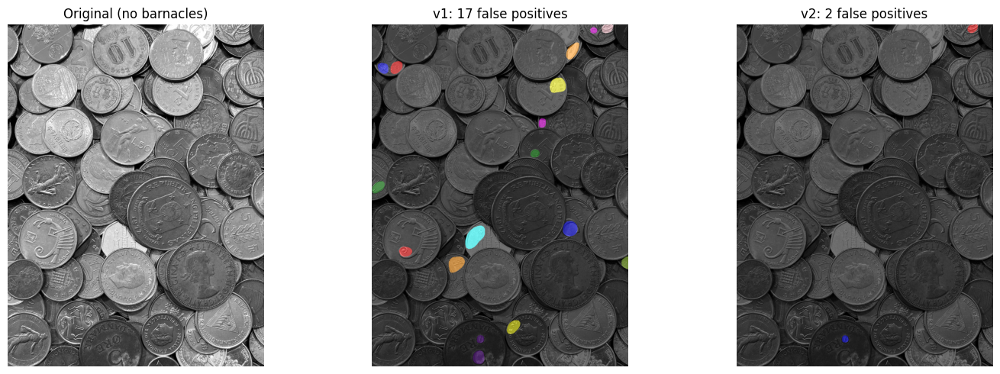


star/negs/coins3.jpg:
  v1 (no negatives): detected 72 'barnacles' (false positives)
  v2 (with negatives): detected 4 'barnacles' (false positives)


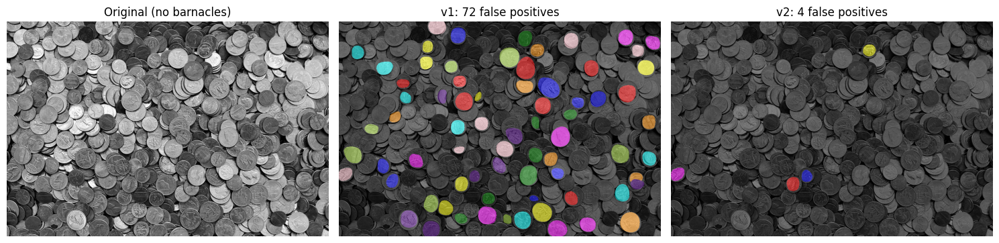

In [232]:

for neg_path in negative_images:
    img = cv.imread(neg_path, cv.IMREAD_GRAYSCALE)
    if img is None:
        continue
    
    img_norm = normalize(img, 1, 99.8)
    
    pred_v1, _ = model_finetuned.predict_instances(img_norm, prob_thresh=prob_thresh)
    pred_v2, _ = model_v2.predict_instances(img_norm, prob_thresh=prob_thresh2)
    
    print(f"\n{neg_path}:")
    print(f"  v1 (no negatives): detected {pred_v1.max()} 'barnacles' (false positives)")
    print(f"  v2 (with negatives): detected {pred_v2.max()} 'barnacles' (false positives)")
    
    # Visualize
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    
    axes[0].imshow(img, cmap='gray')
    axes[0].set_title('Original (no barnacles)')
    axes[0].axis('off')
    
    overlay_v1 = label2rgb(pred_v1, img, bg_label=0, alpha=0.5)
    axes[1].imshow(overlay_v1)
    axes[1].set_title(f'v1: {pred_v1.max()} false positives')
    axes[1].axis('off')
    
    overlay_v2 = label2rgb(pred_v2, img, bg_label=0, alpha=0.5)
    axes[2].imshow(overlay_v2)
    axes[2].set_title(f'v2: {pred_v2.max()} false positives')
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()

  Detected: 1510 barnacles


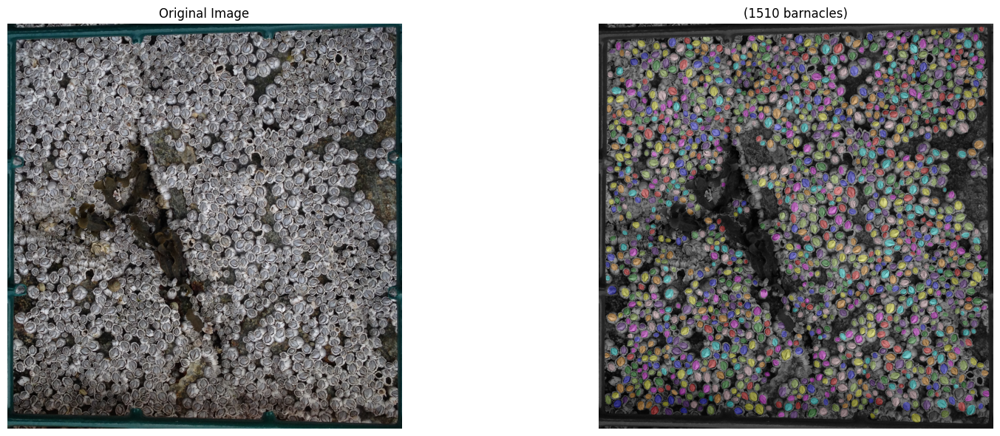

  Detected: 338 barnacles


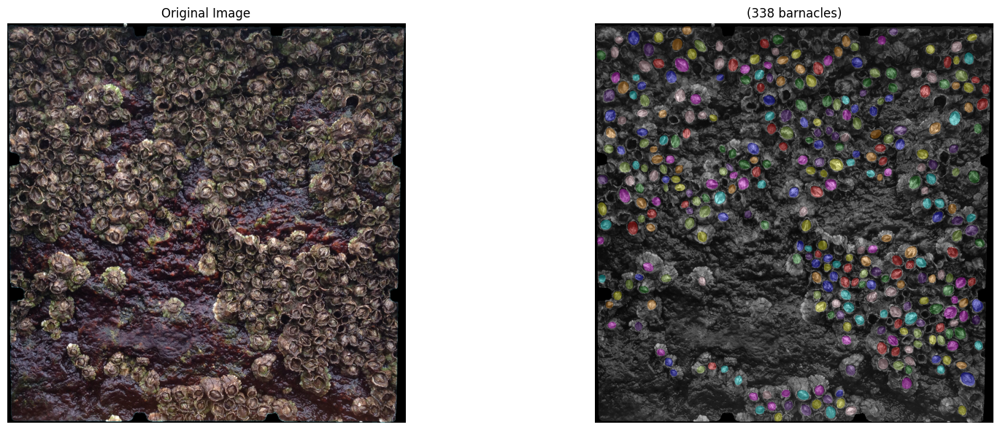

  Detected: 919 barnacles


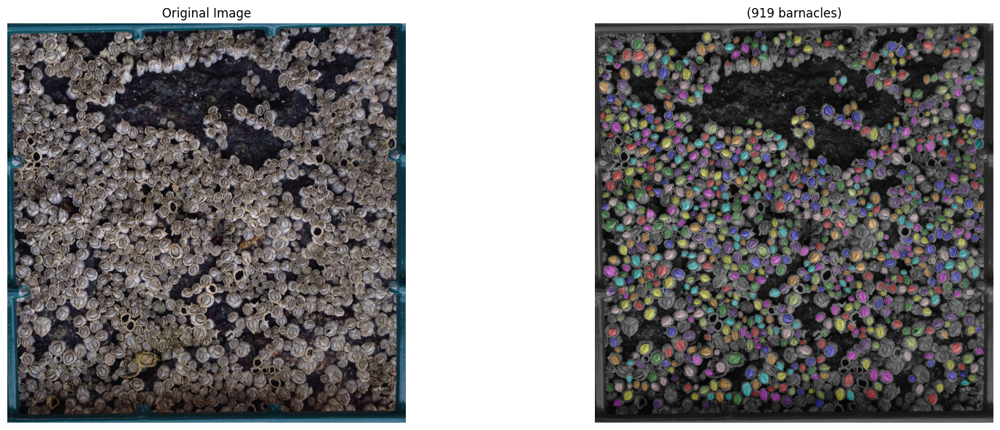

  Detected: 5 barnacles


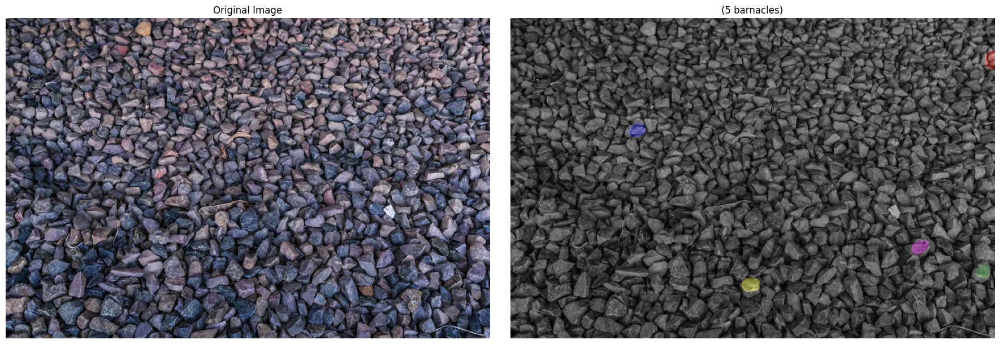

  Detected: 117 barnacles


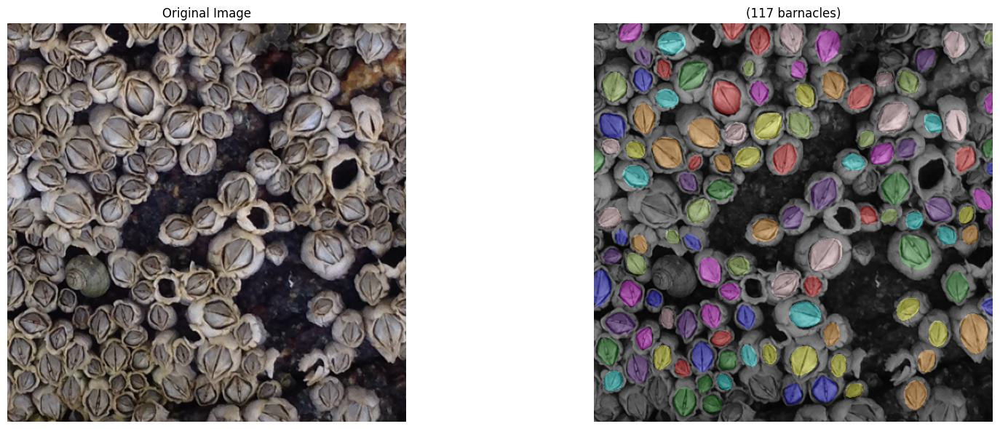

In [233]:

for d in testing_data: 
    img = cv.imread(d, cv.IMREAD_COLOR)

    #normalizing input to have a smaller range 
    img_norm = normalize((cv.cvtColor(img, cv.COLOR_RGB2GRAY)), 1, 99.8)
    labels_pred, details = model_v2.predict_instances(img_norm, prob_thresh = prob_thresh2)
    print(f"  Detected: {labels_pred.max()} barnacles")    

    fig, axes = plt.subplots(1, 2, figsize=(18, 6))
    
    axes[0].imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
    axes[0].set_title('Original Image')
    axes[0].axis('off')
    
    
    overlay_pred = label2rgb(labels_pred, img, bg_label=0, alpha=0.3)
    axes[1].imshow(overlay_pred)
    axes[1].set_title(f'({labels_pred.max()} barnacles)')
    axes[1].axis('off')
    
    plt.tight_layout()
    plt.show()